## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

  import numpy.matlib as npm

  autumn = cm.get_cmap('autumn', 256)

  winter = cm.get_cmap('winter_r', 256)



In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn
absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn


<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 2.5%
RAM Usage: 3.1%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

#### Simulation tests <a id="sims"></a>

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome_PCA
processing_type:  None
features ['transcriptome_PCA']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: zhrk2gvw
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/zhrk2gvw
Initialized sweep with ID: zhrk2gvw
1
3
4
BEST CONFIG {'input_dim': 54, 'binarize': False, 'learning_rate': 0.0005, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.01, 'epochs': 100}
Number of learnable parameters in bilinear CM layer: 730


  warnings.warn(



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB
Best val loss so far at epoch 1: 134.0391
Best val loss so far at epoch 2: 32.3885
Best val loss so far at epoch 3: 10.9301
Best val loss so far at epoch 4: 4.9485
Best val loss so far at epoch 5: 2.6373
Epoch 5/100, Train Loss: 1.2493, Val Loss: 2.6373, Time: 1.08s
Best val loss so far at epoch 6: 1.4978
Best val loss so far at epoch 7: 0.8986
Best val loss so far at epoch 8: 0.5619
Best val loss so far at epoch 9: 0.3593
Best val loss so far at epoch 10: 0.2290
Epoch 10/100, Train Loss: 0.1025, Val Loss: 0.2290, Time: 1.08s
Best val loss so far at epoch 11: 0.1510
Best val loss so far at epoch 12: 0.1011
Best val loss so far at epoch 13: 0.0713
Best val loss so far at epoch 14: 0.0533
Best val loss so far at epoch 15: 0.0432
Epoch 15/100, Train Loss: 0.0337, Val Loss: 0.0432, Time: 0.77s
Best val loss so far at epoch 16: 0.0378
Best val loss so far at epoch 17: 0.0352
Best val loss so far at epoch 18: 0.0342


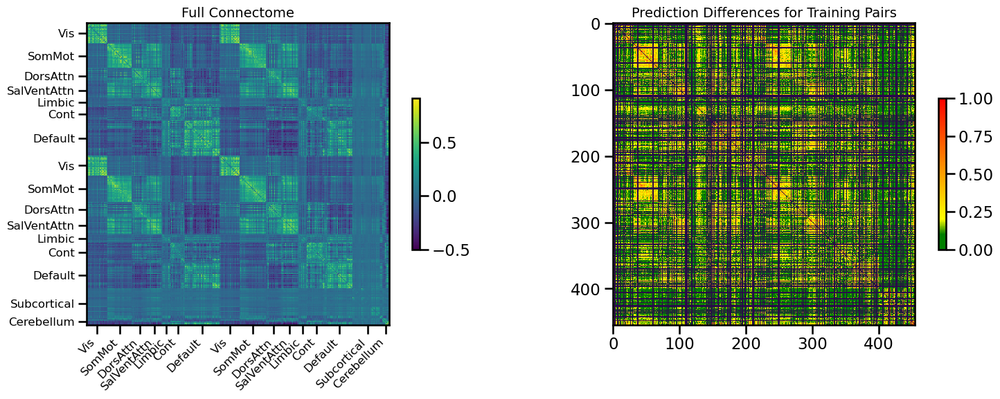

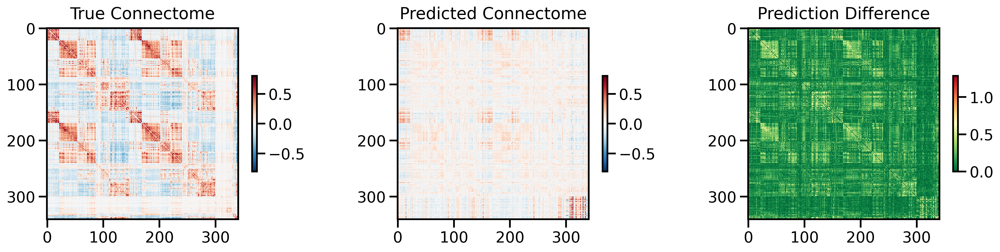

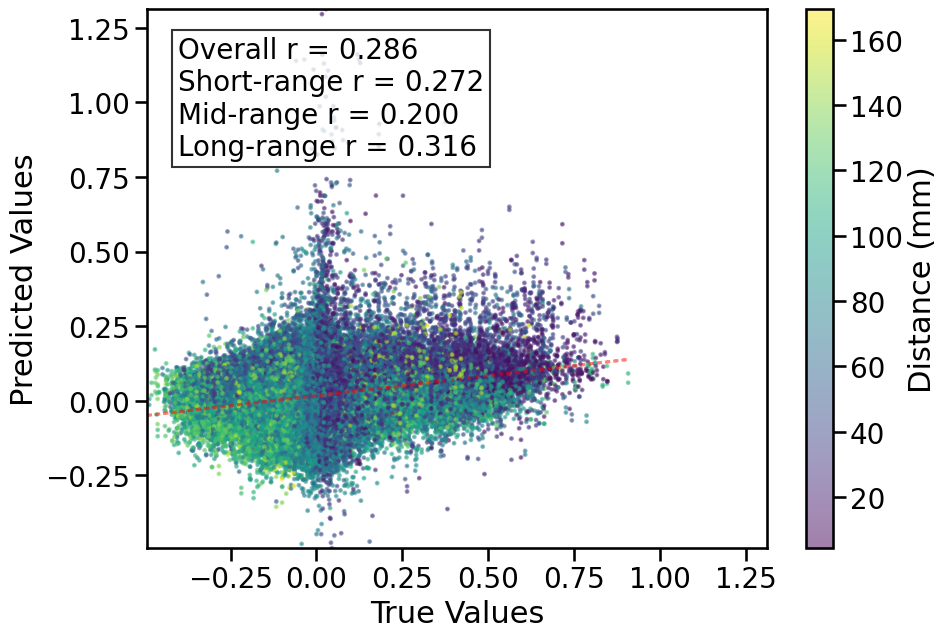

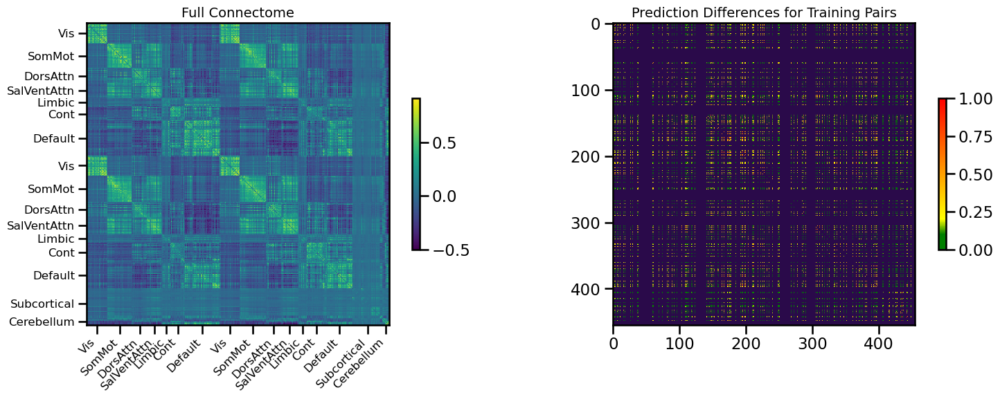

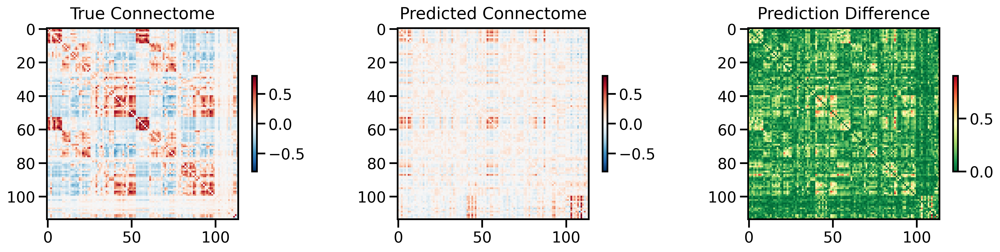

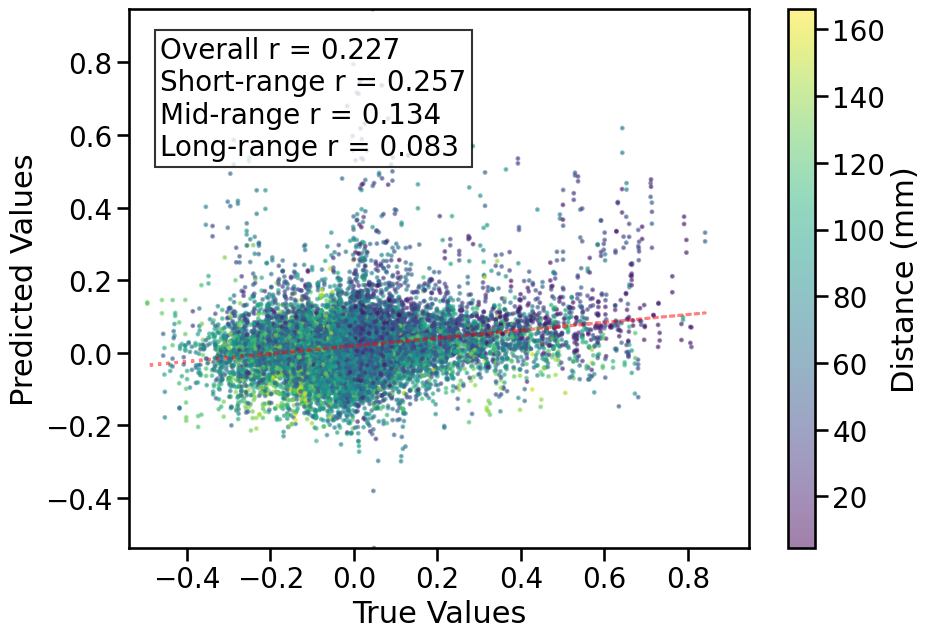


TRAIN METRICS: {'mse': 0.031704523, 'mae': 0.13607258, 'r2': 0.04850055916173812, 'pearson_r': 0.2858407667971292, 'short_r': 0.2718634187799632, 'mid_r': 0.199863242054586, 'long_r': 0.315747582023539, 'geodesic_distance': 34.65142390849227}
TEST METRICS: {'mse': 0.036375772, 'mae': 0.14350767, 'r2': -0.009904652499929556, 'pearson_r': 0.2274368523241762, 'short_r': 0.25681429526005267, 'mid_r': 0.13418723208920952, 'long_r': 0.08278907869253652, 'geodesic_distance': 19.548467035439067}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'learning_rate': 0.0005, 'epochs': 100, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.01}
CPU Usage: 4.9%
RAM Usage: 6.8%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  6% |
Sim complete
Simulation completed in 118.30 seconds (1.97 minutes)


36742

In [8]:
single_sim_run(
              feature_type=[{'transcriptome_PCA': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_CM',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: pkm8zucz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/pkm8zucz
Initialized sweep with ID: pkm8zucz


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 125}
Number of learnable parameters in bilinear low rank model: 73800
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0364
Best val loss so far at epoch 2: 0.0357
Best val loss so far at epoch 3: 0.0357
Best val loss so far at epoch 4: 0.0348
Epoch 5/125, Train Loss: 0.0303, Val Loss: 0.0360, Time: 2.49s
Best val loss so far at epoch 8: 0.0340
Best val loss so far at epoch 9: 0.0339
Best val loss so far at epoch 10: 0.0338
Epoch 10/125, Train Loss: 0.0261, Val Loss: 0.0338, Time: 2.54s
Epoch 15/125, Train Loss: 0.0258, Val Loss: 0.0340, Time: 2.46s
Epoch 20/125, Train Loss: 0.0256, Val Loss: 0.0343, Time: 2.46s
Epoch 25/125, Train Loss: 0.0252, Val Loss: 0.0348, Time: 2.80s

LR REDUCED: 0.000100 → 0.000030

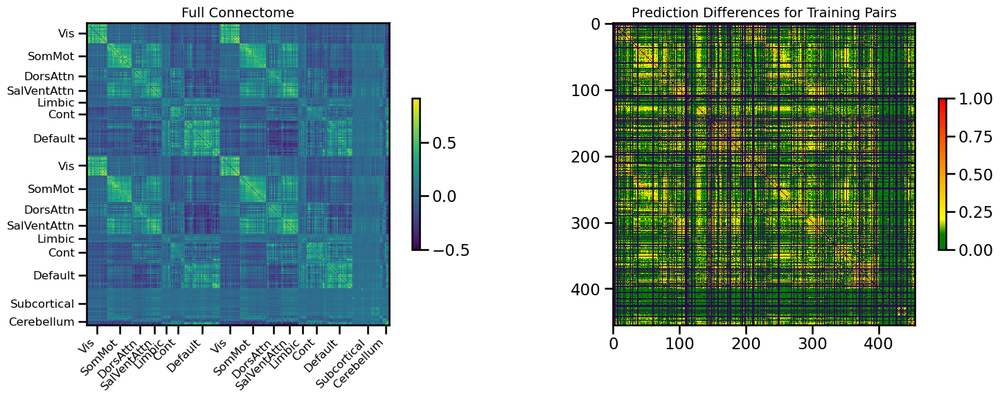

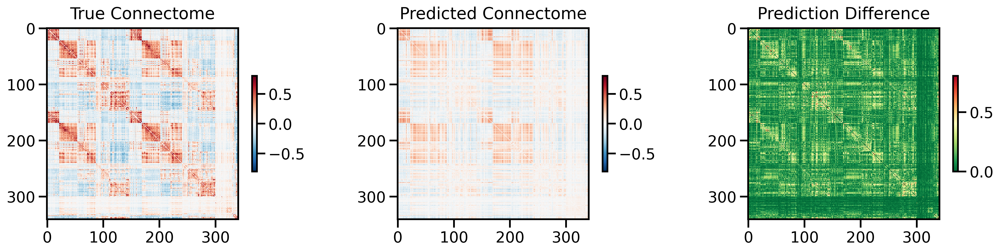

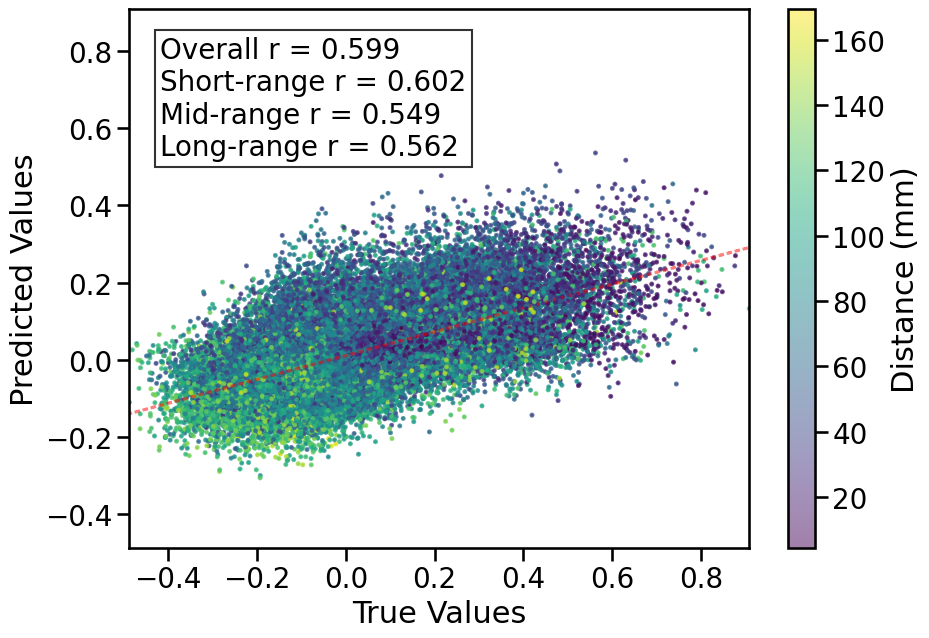

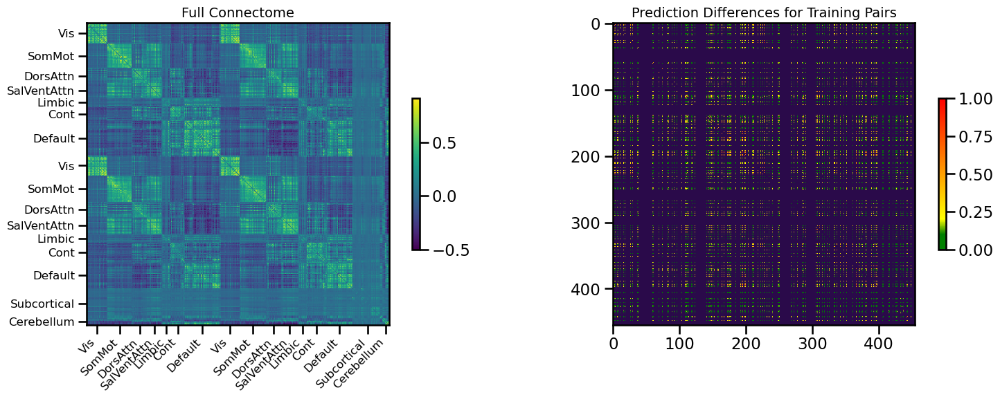

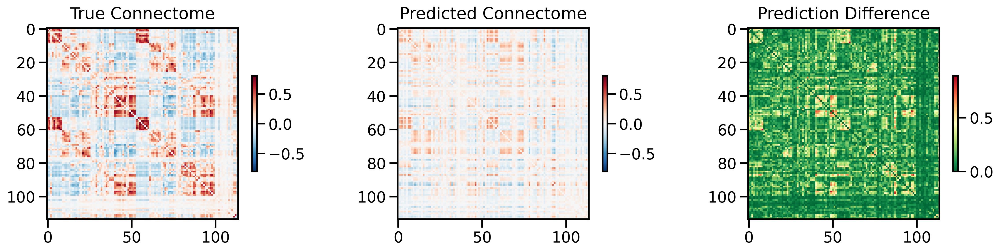

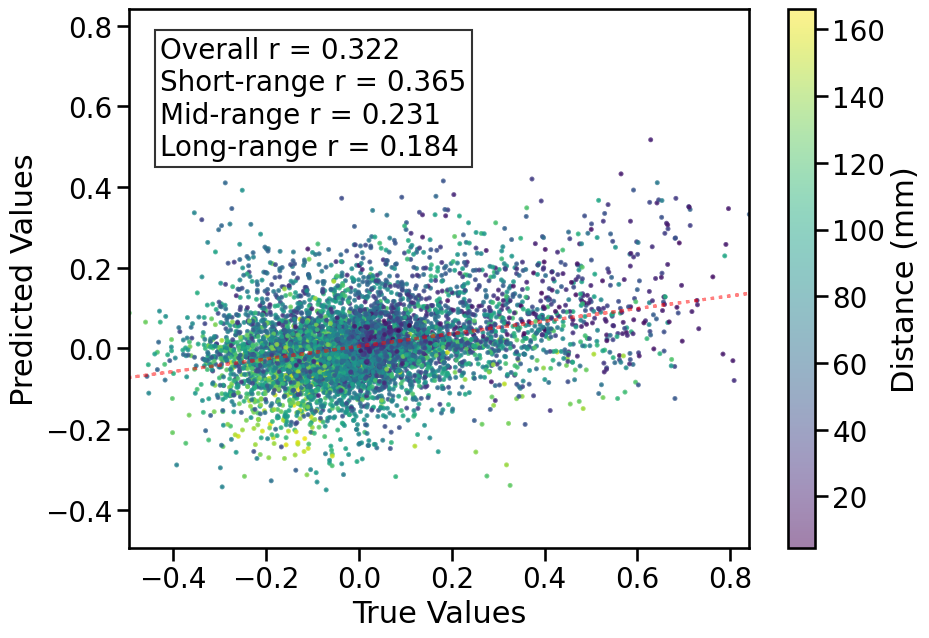


TRAIN METRICS: {'mse': 0.02159325, 'mae': 0.108276635, 'r2': 0.3519548063592969, 'pearson_r': 0.5993999687030506, 'short_r': 0.6024083070449434, 'mid_r': 0.5492955493193737, 'long_r': 0.5622042489714809, 'geodesic_distance': 30.56877157921565}
TEST METRICS: {'mse': 0.03331661, 'mae': 0.13428928, 'r2': 0.07502729620673476, 'pearson_r': 0.3218406876941517, 'short_r': 0.36541841894641014, 'mid_r': 0.23058578630043214, 'long_r': 0.1836294940776954, 'geodesic_distance': 18.75640870080179}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'activation': Identity(), 'learning_rate': 0.0001, 'epochs': 125, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True}
CPU Usage: 5.0%
RAM Usage: 7.6%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  6% |
Sim complete
Simulation completed in 116.76 seconds (1.95 minutes)


36736

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_lowrank',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: z1dgbppn
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/z1dgbppn
Initialized sweep with ID: z1dgbppn


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'n_components': 10, 'max_iter': 1000, 'scale': True, 'optimize_encoder': False, 'learning_rate': 0.0035, 'batch_size': 512, 'weight_decay': 0.01, 'epochs': 100}
X_train shape: torch.Size([341, 7380])
Y_train shape: torch.Size([341, 341])
Total number of parameters: 147722
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 69.1777
Best val loss so far at epoch 2: 25.6807
Best val loss so far at epoch 3: 11.5271
Best val loss so far at epoch 4: 6.1480
Best val loss so far at epoch 5: 3.7638
Epoch 5/100, Train Loss: 3.7618, Val Loss: 3.7638, Time: 2.28s
Best val loss so far at epoch 6: 2.5015
Best val loss so far at epoch 7: 1.7899
Best val loss so far at epoch 8: 1.2981
Best val loss so far at epoch 9: 0.9917
Best val loss so far at epoch 10: 0.7741
Epoch 10/100, Train Loss: 0.7230, Val Loss: 0.7741, Time: 2.45s
Best val loss so far at epoch 11: 0.6194
Best val loss so far 

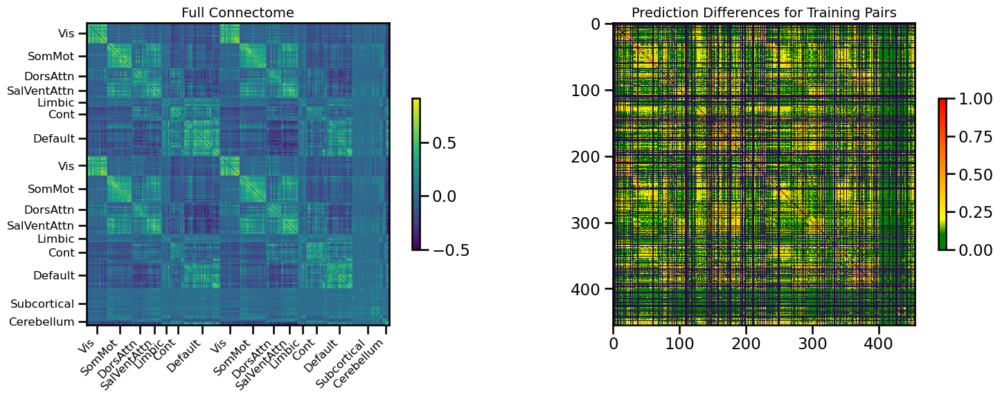

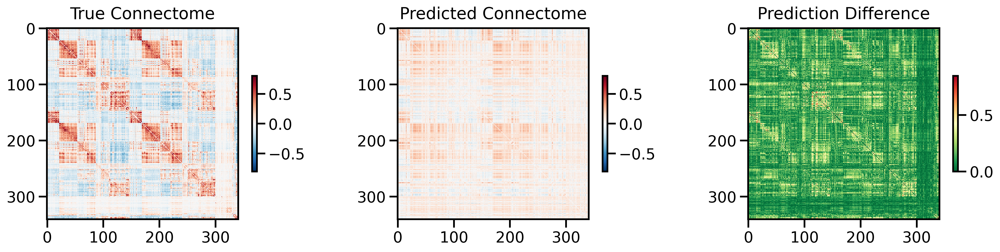

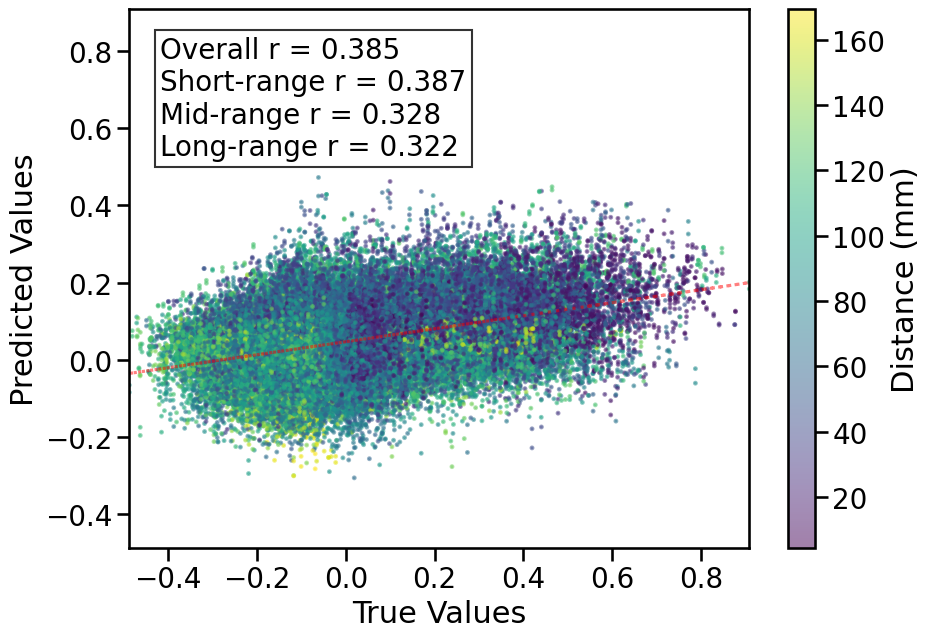

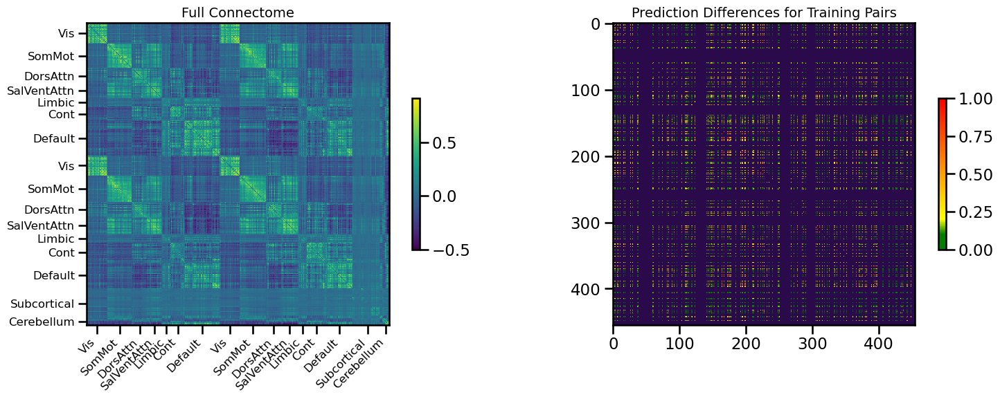

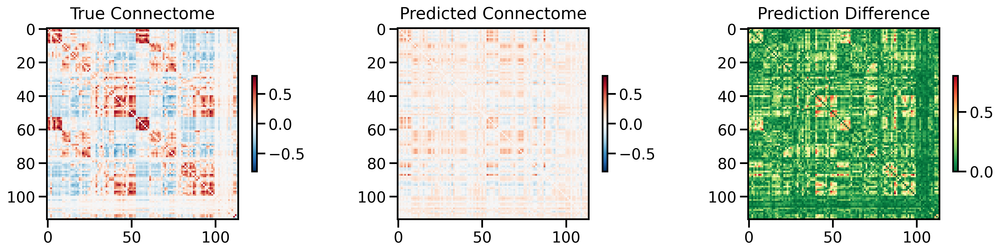

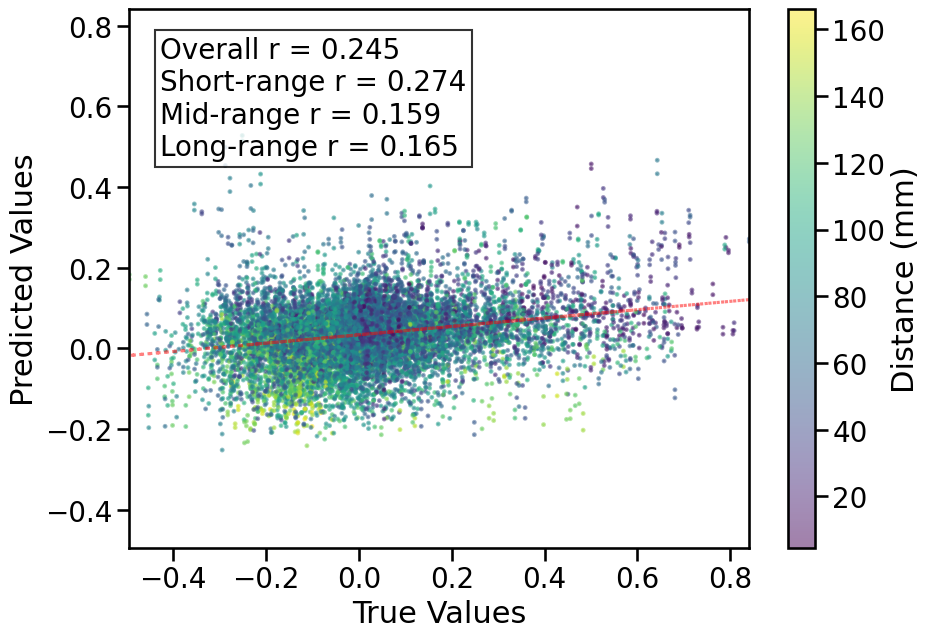


TRAIN METRICS: {'mse': 0.02948185, 'mae': 0.132478, 'r2': 0.11520625470068735, 'pearson_r': 0.38454570715594455, 'short_r': 0.3872806153688816, 'mid_r': 0.3279777992504176, 'long_r': 0.32191289588447447, 'geodesic_distance': 33.67704270247203}
TEST METRICS: {'mse': 0.035382252, 'mae': 0.14180167, 'r2': 0.017678634209151722, 'pearson_r': 0.24482722748656363, 'short_r': 0.2740540232807321, 'mid_r': 0.1590994122747503, 'long_r': 0.1648954782766936, 'geodesic_distance': 18.414905401799462}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'binarize': False, 'optimize_encoder': False, 'batch_size': 512, 'epochs': 100}
CPU Usage: 4.7%
RAM Usage: 7.6%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  6% |
Sim complete
Simulation completed in 270.13 seconds (4.50 minutes)


36764

In [10]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='pls_bilineardecoder',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: coaycbhf
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/coaycbhf
Initialized sweep with ID: coaycbhf


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'n_components': 10, 'max_iter': 1000, 'scale': True, 'optimize_encoder': False, 'hidden_dims': [128, 64], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
X_train shape: torch.Size([341, 7380])
Y_train shape: torch.Size([341, 341])
Total number of parameters: 158993
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0470
Best val loss so far at epoch 2: 0.0395
Best val loss so far at epoch 3: 0.0362
Best val loss so far at epoch 4: 0.0348
Best val loss so far at epoch 5: 0.0341
Epoch 5/100, Train Loss: 0.0536, Val Loss: 0.0341, Time: 2.66s
Best val loss so far at epoch 6: 0.0337
Best val loss so far at epoch 7: 0.0335
Best val loss so far at epoch 8: 0.0335
Best val loss so far at epoch 9: 0.0334
Best val loss so far at epoch 10: 0.0333
Epoch 10/100, Train Loss: 0.0326, Val Loss: 0.0333, Time: 2.28s
Best val loss so 

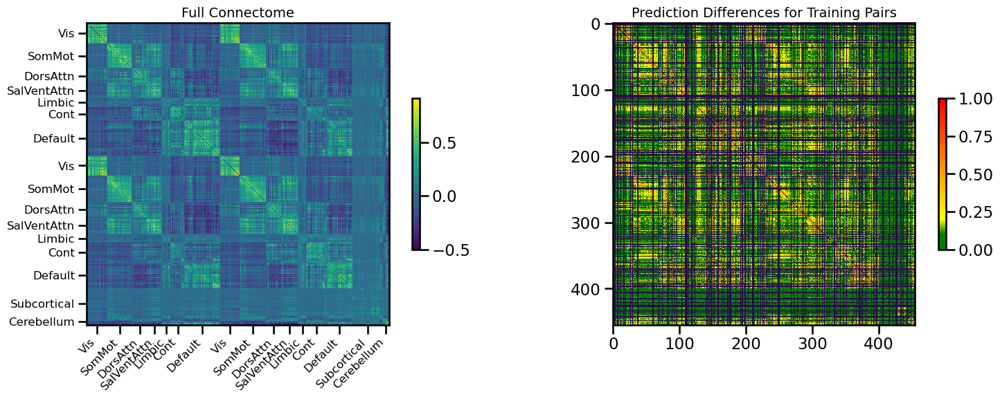

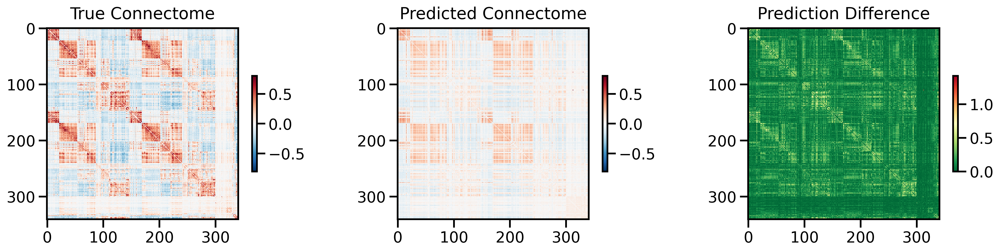

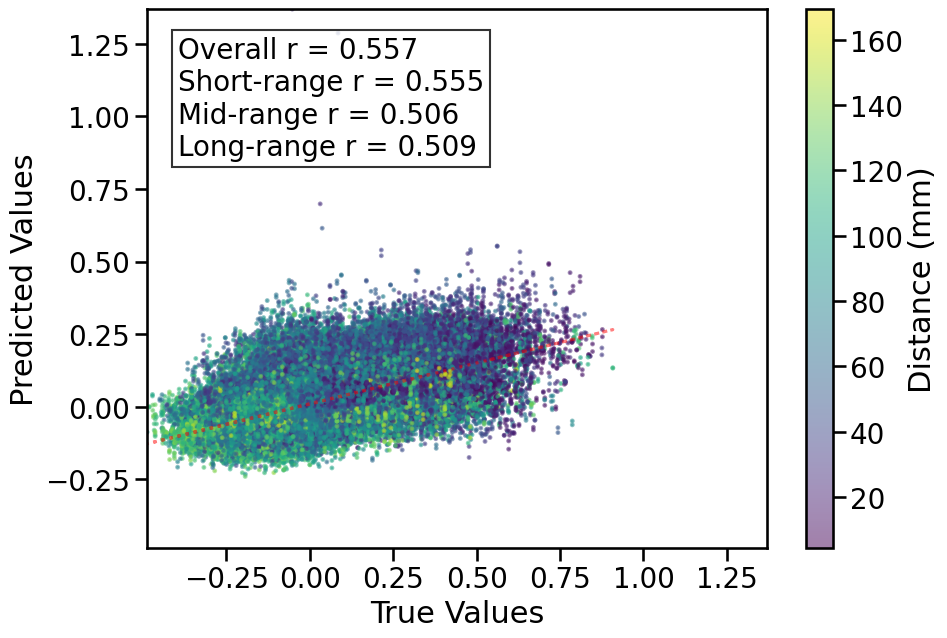

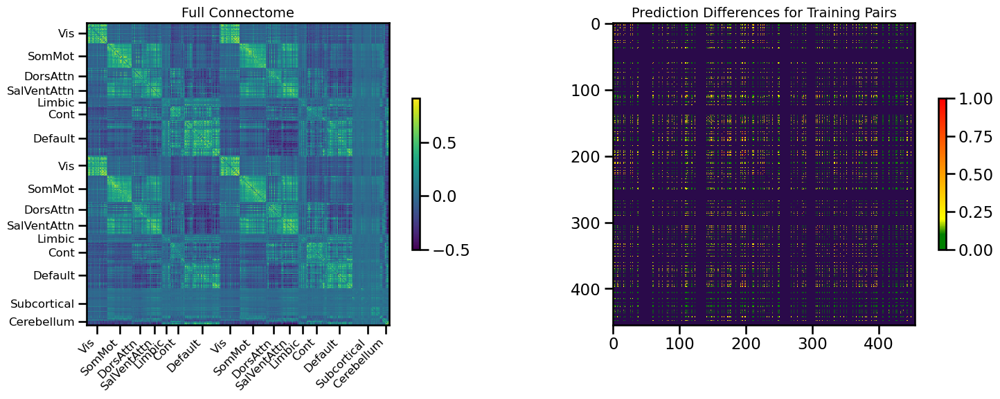

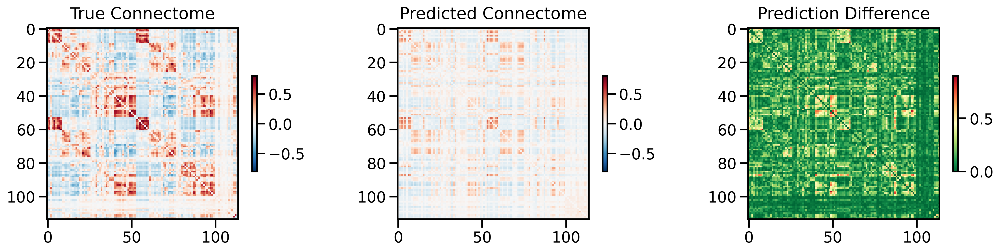

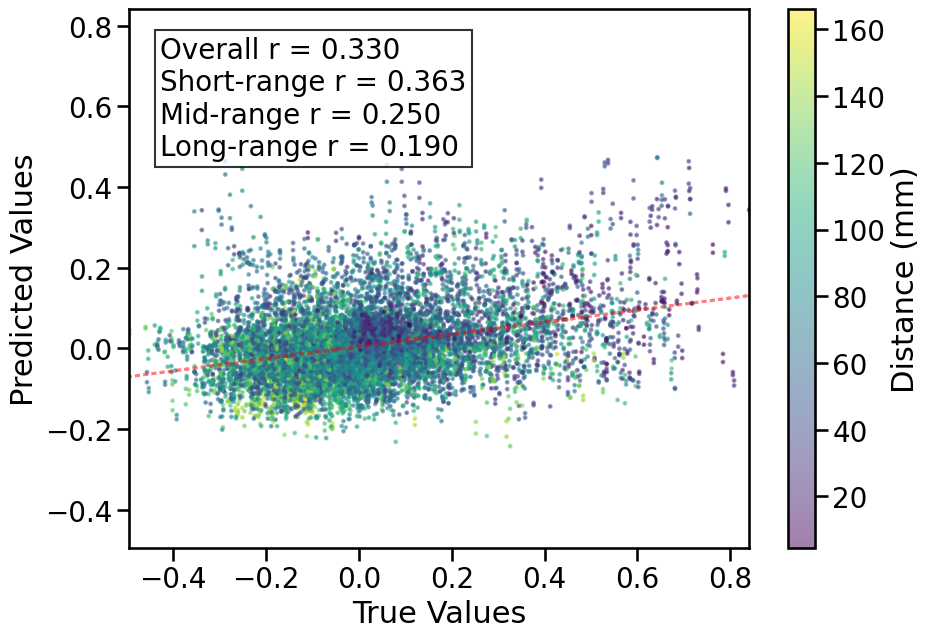


TRAIN METRICS: {'mse': 0.023096912, 'mae': 0.11136439, 'r2': 0.30682761650883617, 'pearson_r': 0.556597553168031, 'short_r': 0.555396103920546, 'mid_r': 0.5062221720837462, 'long_r': 0.5090720462824089, 'geodesic_distance': 33.361820758842875}
TEST METRICS: {'mse': 0.03274505, 'mae': 0.1313196, 'r2': 0.09089558732567515, 'pearson_r': 0.3301381278365908, 'short_r': 0.3628732607922042, 'mid_r': 0.25006519693740614, 'long_r': 0.1896757701096567, 'geodesic_distance': 20.254546167957333}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'binarize': False, 'optimize_encoder': False, 'batch_size': 512, 'epochs': 100}
CPU Usage: 5.8%
RAM Usage: 7.6%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  6% |
Sim complete
Simulation completed in 172.78 seconds (2.88 minutes)


36764

In [11]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='pls_mlpdecoder',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 0v41jt8i
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/0v41jt8i
Initialized sweep with ID: 0v41jt8i


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0380
Best val loss so far at epoch 2: 0.0356
Best val loss so far at epoch 4: 0.0347
Best val loss so far at epoch 5: 0.0343
Epoch 5/100, Train Loss: 0.0531, Val Loss: 0.0343, Time: 2.19s
Best val loss so far at epoch 6: 0.0332
Epoch 10/100, Train Loss: 0.0257, Val Loss: 0.0371, Time: 2.41s
Epoch 15/100, Train Loss: 0.0195, Val Loss: 0.0384, Time: 2.32s
Epoch 20/100, Train Loss: 0.0159, Val Loss: 0.0410, Time: 2.27s
Epoch 25/100, Train Loss: 0.0131, Val Loss: 0.0450, Time: 2.44s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.068331
Epoch 30/100, Train Loss: 0.0099, Val Loss: 0.0459, Time: 2.10s
Epoch 35/100, Train Loss: 0.0091, Val Loss: 0.0482,

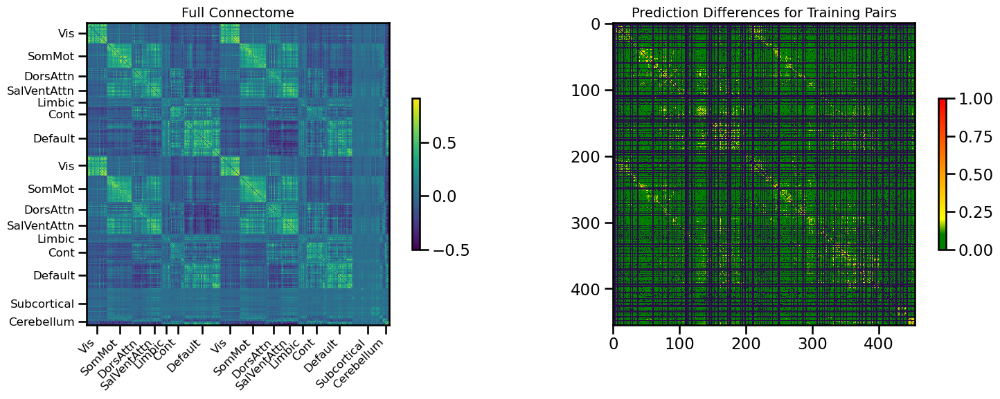

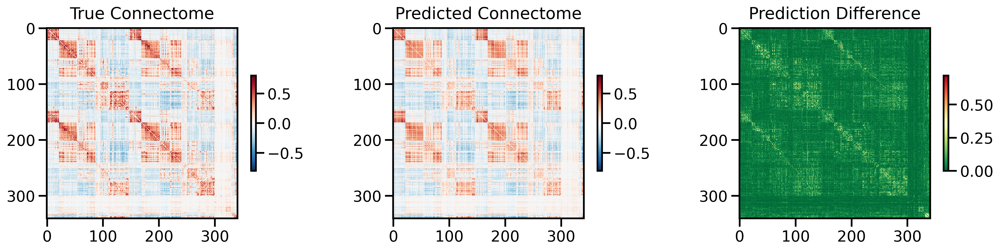

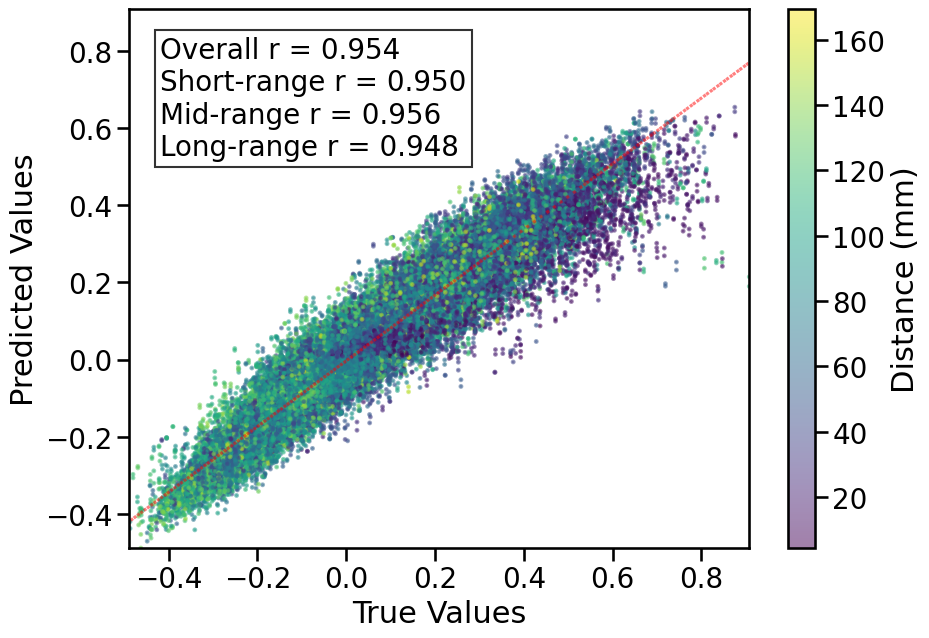

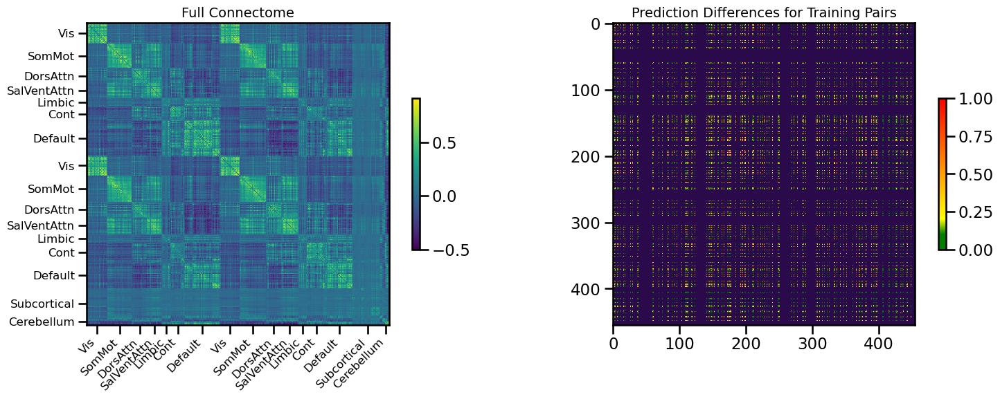

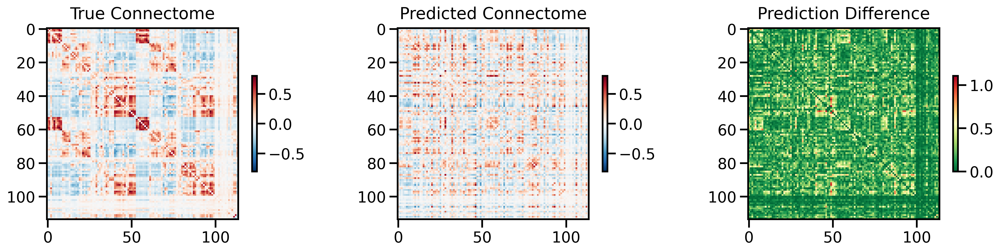

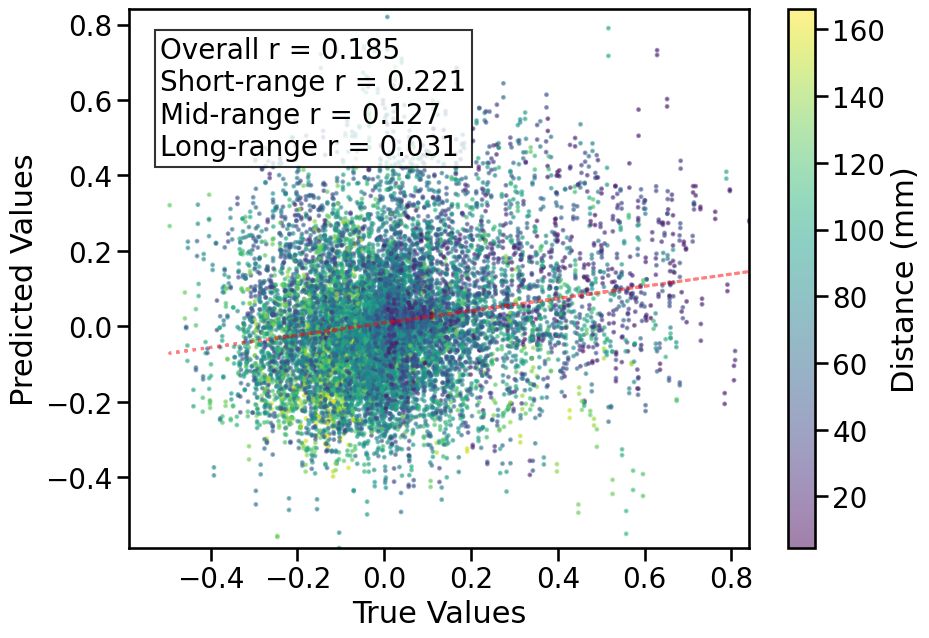


TRAIN METRICS: {'mse': 0.003158367, 'mae': 0.03803224, 'r2': 0.9052127575109911, 'pearson_r': 0.9540698309702749, 'short_r': 0.9495275252374362, 'mid_r': 0.9557397161416018, 'long_r': 0.9481375749162019, 'geodesic_distance': 19.888797032770874}
TEST METRICS: {'mse': 0.052110042, 'mae': 0.17098342, 'r2': -0.4467368212892515, 'pearson_r': 0.1846819046043087, 'short_r': 0.22071908827065354, 'mid_r': 0.12709882409637685, 'long_r': 0.030938689254391864, 'geodesic_distance': 18.033436923727557}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}
CPU Usage: 2.9%
RAM Usage: 4.3%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 274.31 seconds (4.57 minutes)


36842

In [11]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome_PCA
processing_type:  None
features ['transcriptome_PCA']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 35ffrpki
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/35ffrpki
Initialized sweep with ID: 35ffrpki


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 54, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 47873
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0435
Best val loss so far at epoch 2: 0.0373
Best val loss so far at epoch 3: 0.0357
Best val loss so far at epoch 4: 0.0342
Best val loss so far at epoch 5: 0.0338
Epoch 5/100, Train Loss: 0.0464, Val Loss: 0.0338, Time: 0.87s
Best val loss so far at epoch 6: 0.0334
Best val loss so far at epoch 7: 0.0334
Best val loss so far at epoch 8: 0.0332
Best val loss so far at epoch 9: 0.0332
Best val loss so far at epoch 10: 0.0329
Epoch 10/100, Train Loss: 0.0312, Val Loss: 0.0329, Time: 0.87s
Best val loss so far at epoch 12: 0.0329
Best val loss so far at epoch 13: 0.0327
Best val loss so far at epoch 14: 0.0326
Epoch 15/100, Train Loss: 0.0290, Val Loss:

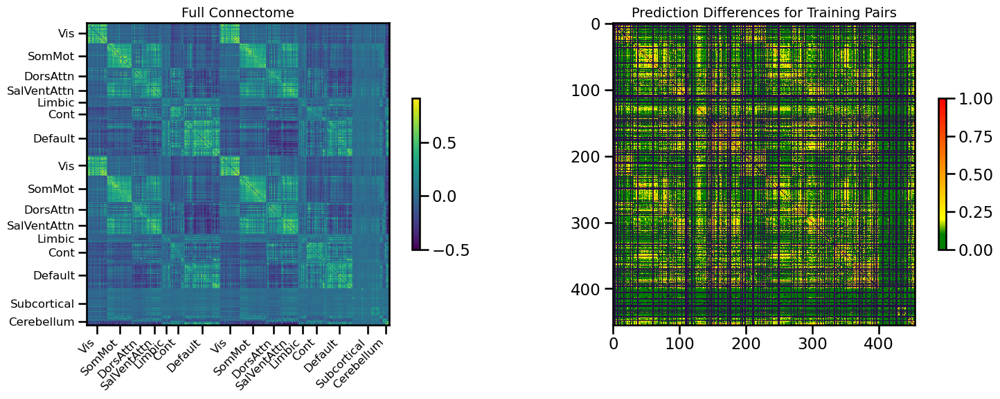

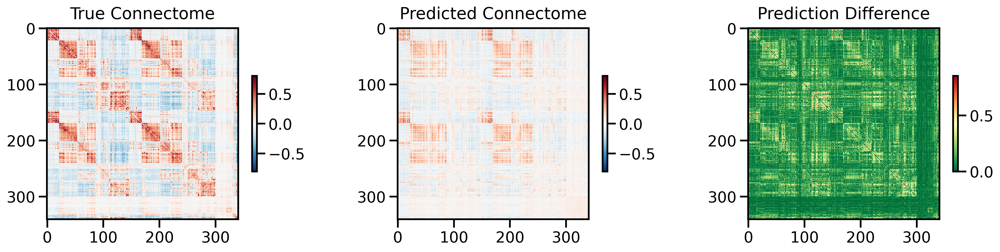

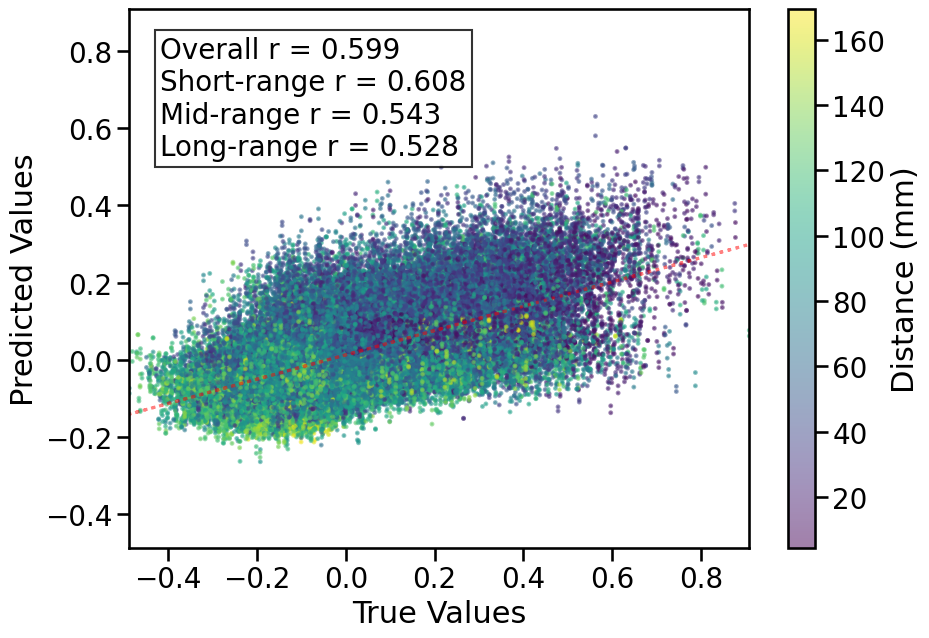

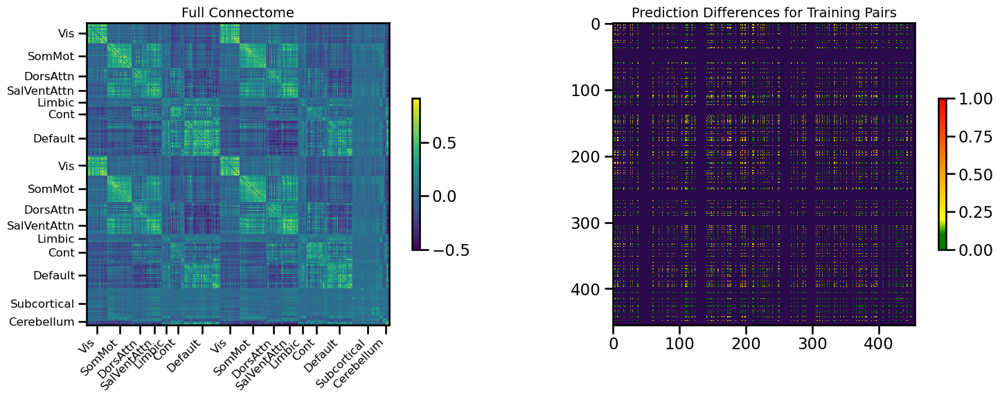

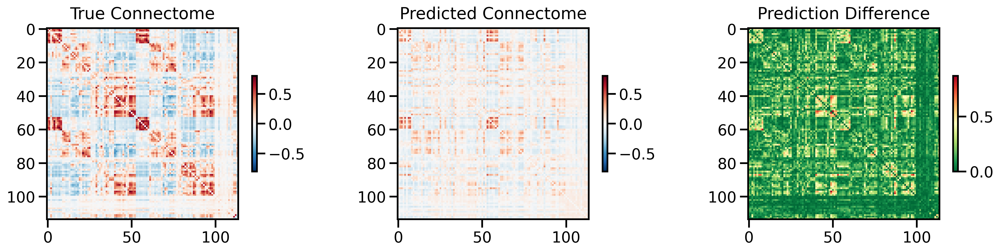

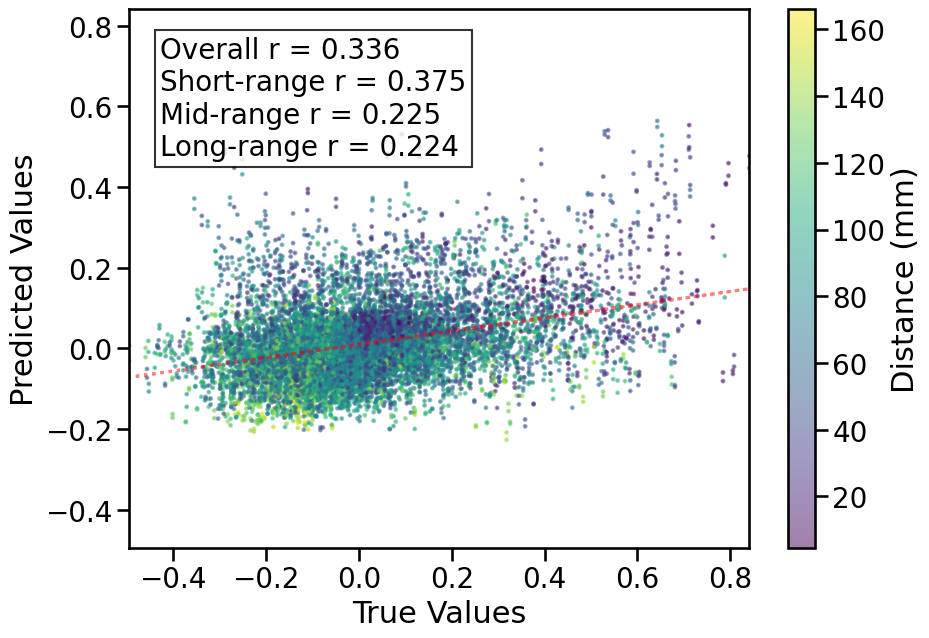


TRAIN METRICS: {'mse': 0.02154719, 'mae': 0.10738656, 'r2': 0.3533370819172853, 'pearson_r': 0.5988856792432332, 'short_r': 0.6079368969364541, 'mid_r': 0.5432848312360059, 'long_r': 0.5283522699473716, 'geodesic_distance': 31.7679831555878}
TEST METRICS: {'mse': 0.032791797, 'mae': 0.13156755, 'r2': 0.08959777377604439, 'pearson_r': 0.33633456163272457, 'short_r': 0.3749272138078508, 'mid_r': 0.22529322482170228, 'long_r': 0.2242301473404423, 'geodesic_distance': 18.945668133081583}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 54, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}
CPU Usage: 4.9%
RAM Usage: 6.8%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  6% |
Sim complete
Simulation completed in 102.30 seconds (1.71 minutes)


36773

In [13]:
single_sim_run(
              feature_type=[{'transcriptome_PCA': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
features ['transcriptome', 'euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: mwod9p51
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/mwod9p51
Initialized sweep with ID: mwod9p51


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14766, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3814145
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0341
Best val loss so far at epoch 2: 0.0318
Best val loss so far at epoch 3: 0.0309
Best val loss so far at epoch 4: 0.0293
Epoch 5/100, Train Loss: 0.0376, Val Loss: 0.0297, Time: 2.18s
Best val loss so far at epoch 6: 0.0292
Best val loss so far at epoch 7: 0.0291
Epoch 10/100, Train Loss: 0.0228, Val Loss: 0.0311, Time: 2.31s
Epoch 15/100, Train Loss: 0.0172, Val Loss: 0.0375, Time: 2.17s
Epoch 20/100, Train Loss: 0.0145, Val Loss: 0.0382, Time: 2.16s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.045648
Epoch 25/100, Train Loss: 0.0124, Val Loss: 0.0456, Time: 2.14s
Epoch 30/100, Train Loss: 0.0101, Val Loss: 0.0411, Time: 2.14s
Epoch 35/10

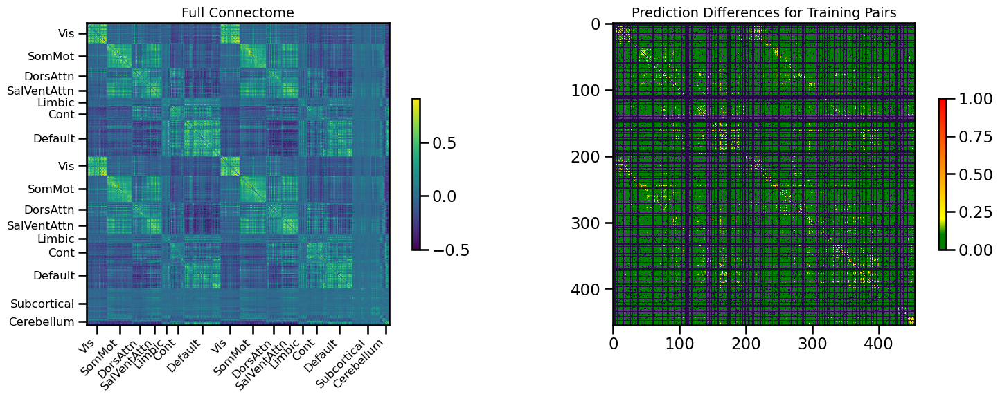

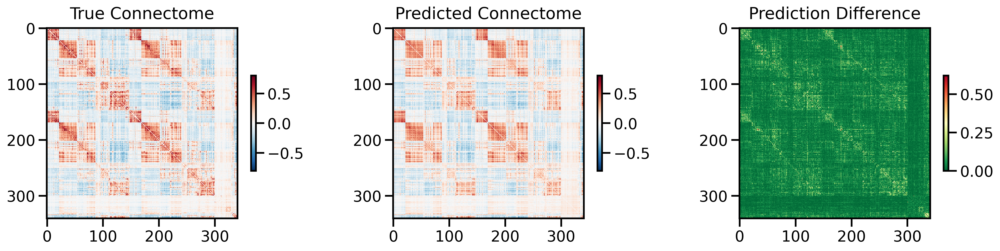

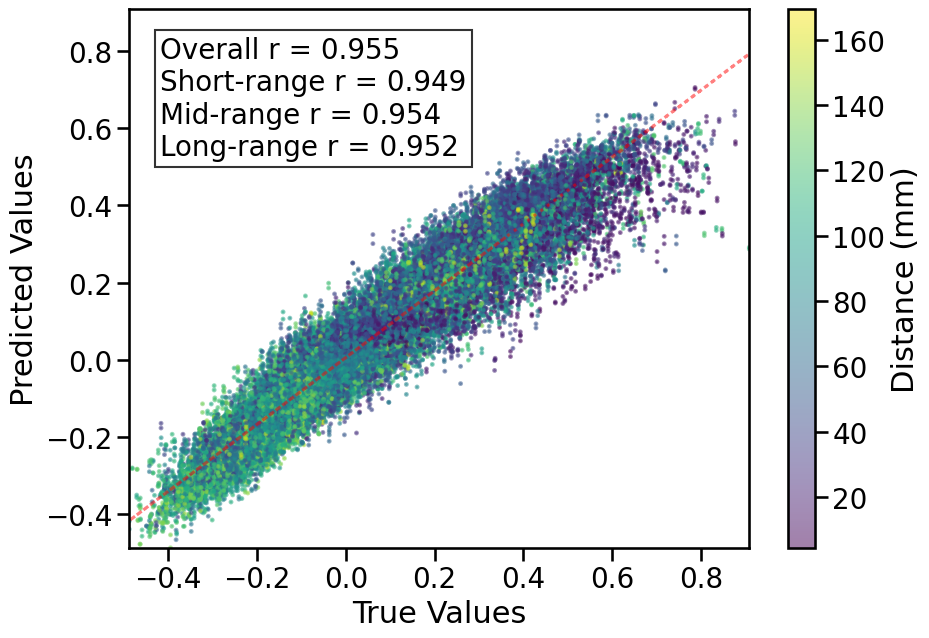

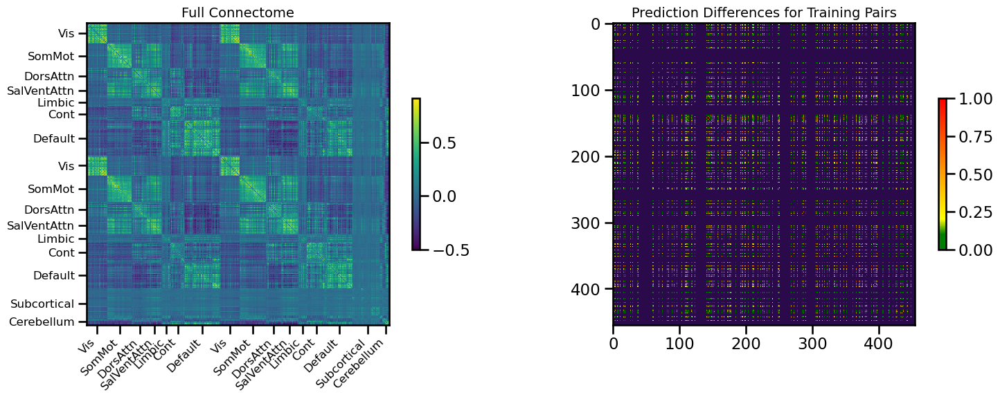

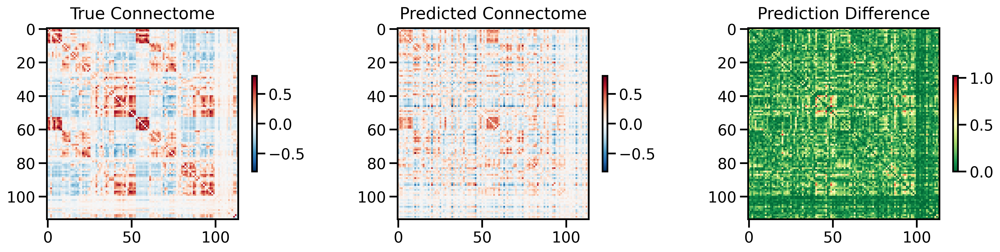

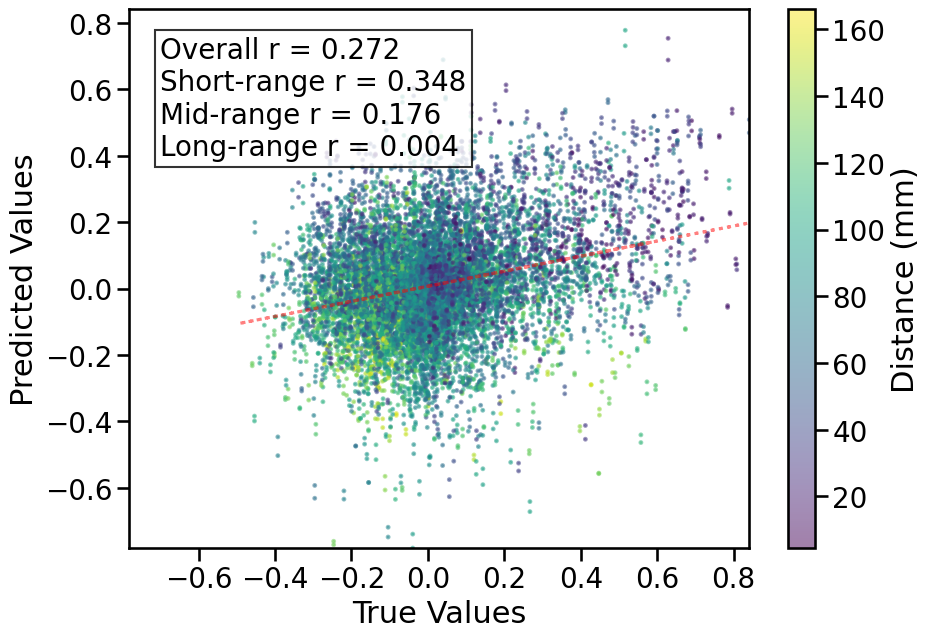


TRAIN METRICS: {'mse': 0.0030382331, 'mae': 0.038963247, 'r2': 0.9088181478649581, 'pearson_r': 0.9547009947000693, 'short_r': 0.9491322047686749, 'mid_r': 0.9544676384976938, 'long_r': 0.9517445749553306, 'geodesic_distance': 17.150729007009595}
TEST METRICS: {'mse': 0.044816017, 'mae': 0.16034126, 'r2': -0.24423198681130343, 'pearson_r': 0.2716108510777567, 'short_r': 0.3483778746573583, 'mid_r': 0.17588112867657643, 'long_r': 0.003943897965621989, 'geodesic_distance': 15.901103986931364}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14766, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}
CPU Usage: 2.8%
RAM Usage: 4.3%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 278.90 seconds (4.65 minutes)


37032

In [12]:
single_sim_run(
              feature_type=[{'transcriptome': None}, {'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 9pjrv0dt
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/9pjrv0dt
Initialized sweep with ID: 9pjrv0dt


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.45, 'epochs': 70}
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0389
Best val loss so far at epoch 2: 0.0355
Best val loss so far at epoch 3: 0.0352
Best val loss so far at epoch 4: 0.0349
Best val loss so far at epoch 5: 0.0340
Epoch 5/70, Train Loss: 0.0680, Val Loss: 0.0340, Time: 5.73s
Best val loss so far at epoch 6: 0.0337
Best val loss so far at epoch 7: 0.0333
Best val loss so far at epoch 9: 0.0330
Epoch 10/70, Train Loss: 0.0544, Val Loss: 0.0334, Time: 5.87s
Epoch 15/70, Train Loss: 0.0473, Val Loss: 0.0346, Time: 6.00s
Epoch 20/70, Train Loss: 0.0381, Val Loss: 0.0393, Time: 5.81s


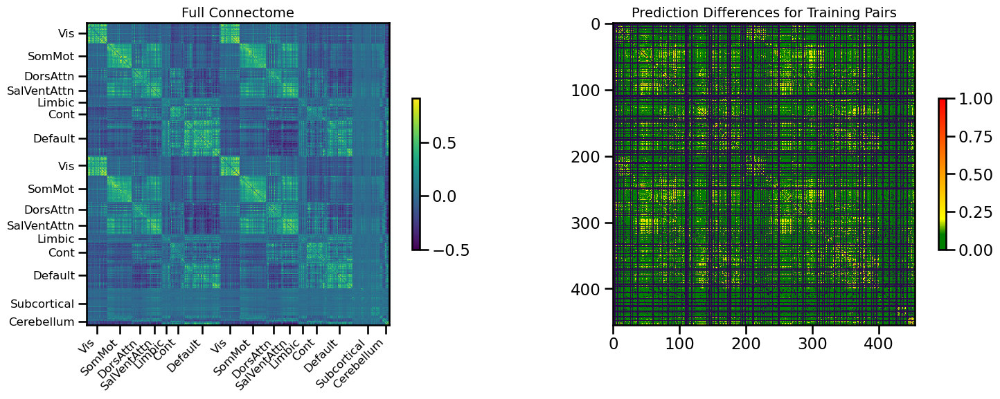

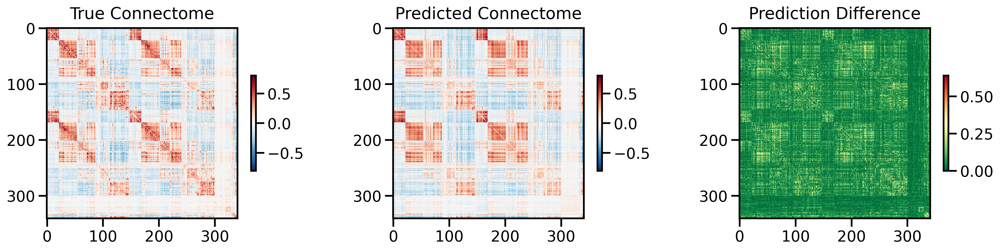

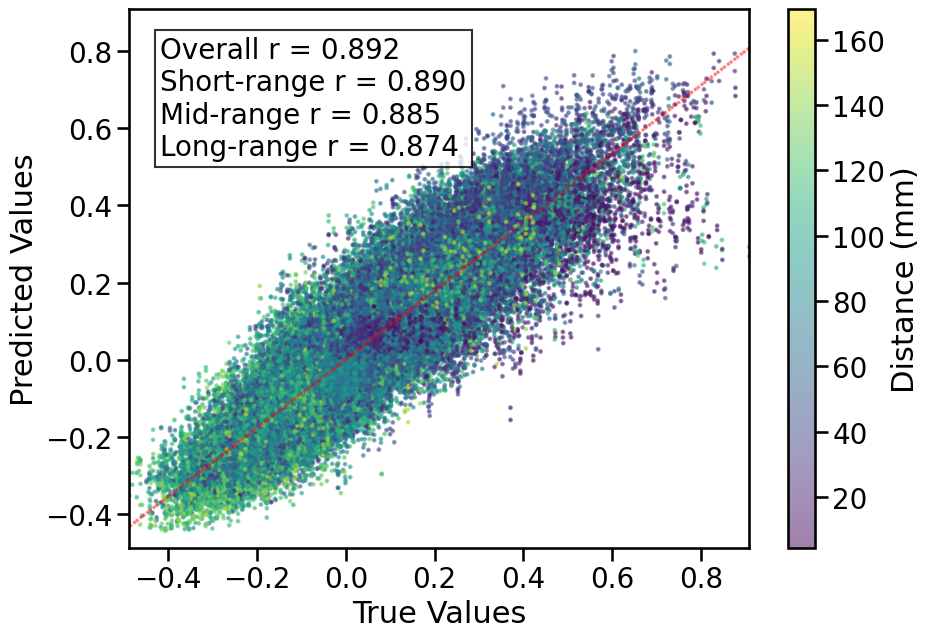

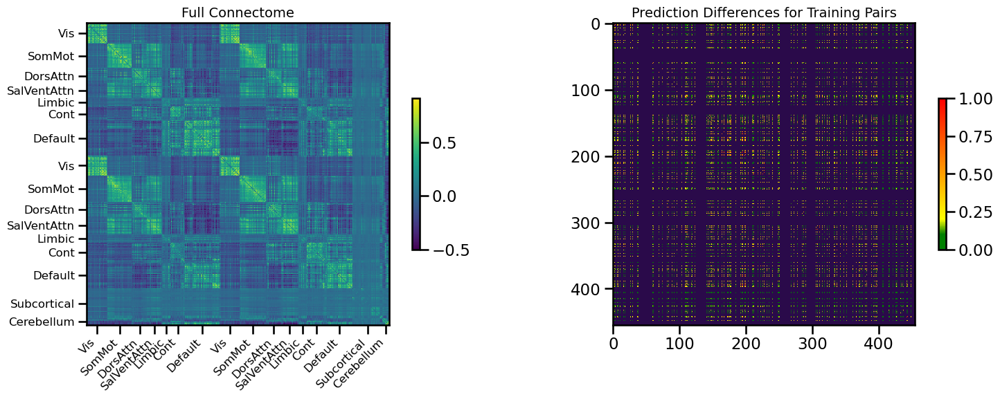

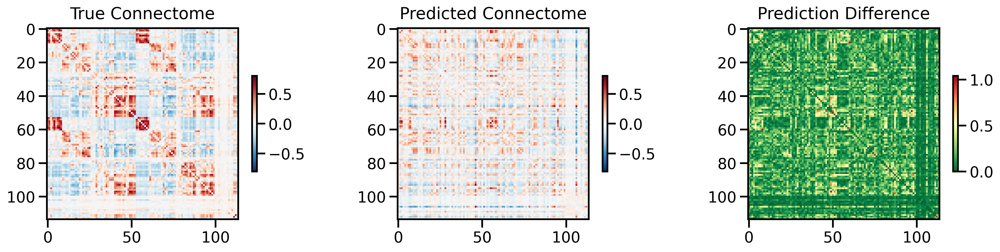

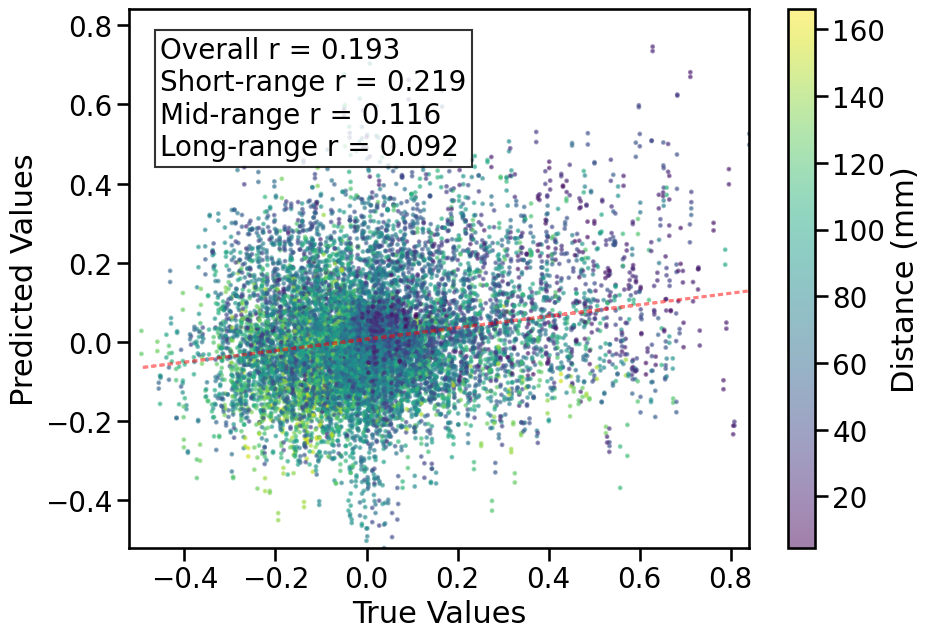


TRAIN METRICS: {'mse': 0.007200956, 'mae': 0.0629017, 'r2': 0.7838887096237681, 'pearson_r': 0.8915286346005628, 'short_r': 0.8896889424170642, 'mid_r': 0.8845515051839504, 'long_r': 0.8736964889857527, 'geodesic_distance': 21.603695414699676}
TEST METRICS: {'mse': 0.046010036, 'mae': 0.16116677, 'r2': -0.2773817635045017, 'pearson_r': 0.19295304762608398, 'short_r': 0.21902978331125653, 'mid_r': 0.1155533828997343, 'long_r': 0.09181733681635247, 'geodesic_distance': 16.702004401978954}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'use_alibi': True, 'batch_size': 512, 'aug_prob': 0.45, 'epochs': 70}
CPU Usage: 4.6%
RAM Usage: 8.6%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  9% |
Sim complete
Simulation completed in 266.08 seconds (4.43 minutes)


48808

In [17]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: au762oym
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/au762oym
Initialized sweep with ID: au762oym
1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.45, 'epochs': 70}


  warnings.warn(



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.01 GB


  warnings.warn(



Best val loss so far at epoch 1: 0.0374
Best val loss so far at epoch 2: 0.0355
Best val loss so far at epoch 3: 0.0306
Best val loss so far at epoch 4: 0.0301
Best val loss so far at epoch 5: 0.0287
Epoch 5/70, Train Loss: 0.0651, Val Loss: 0.0287, Time: 6.33s
Best val loss so far at epoch 6: 0.0286
Best val loss so far at epoch 7: 0.0282
Best val loss so far at epoch 10: 0.0267
Epoch 10/70, Train Loss: 0.0435, Val Loss: 0.0267, Time: 5.64s
Best val loss so far at epoch 11: 0.0252
Best val loss so far at epoch 12: 0.0243
Best val loss so far at epoch 13: 0.0239
Best val loss so far at epoch 14: 0.0233
Best val loss so far at epoch 15: 0.0211
Epoch 15/70, Train Loss: 0.0385, Val Loss: 0.0211, Time: 5.59s
Epoch 20/70, Train Loss: 0.0353, Val Loss: 0.0228, Time: 6.34s
Best val loss so far at epoch 24: 0.0208
Epoch 25/70, Train Loss: 0.0261, Val Loss: 0.0219, Time: 5.66s
Best val loss so far at epoch 27: 0.0206
Epoch 30/70, Train Loss: 0.0229, Val Loss: 0.0226, Time: 5.70s
Best val loss s

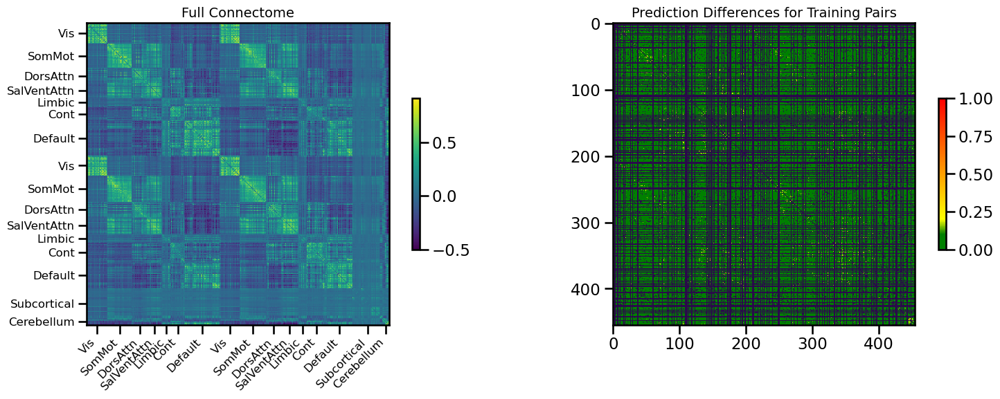

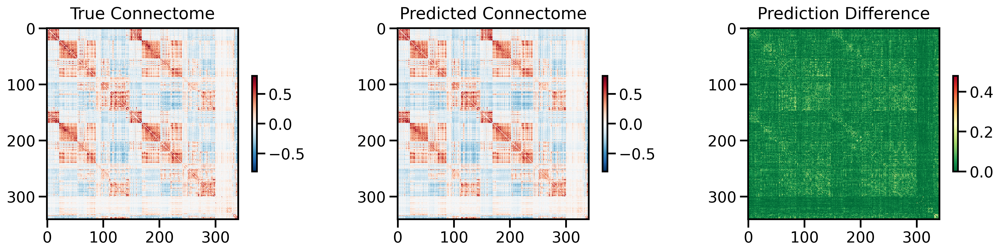

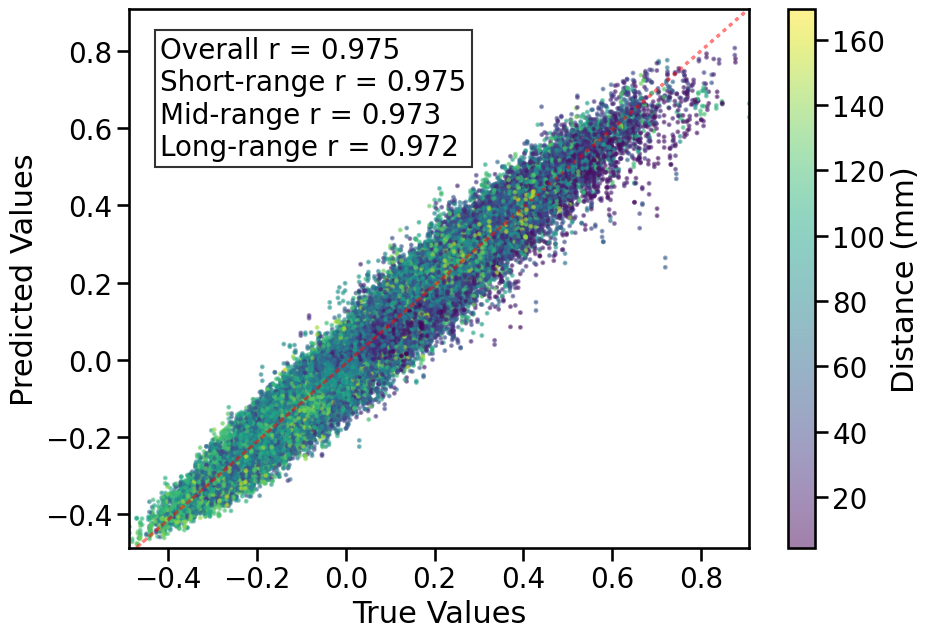

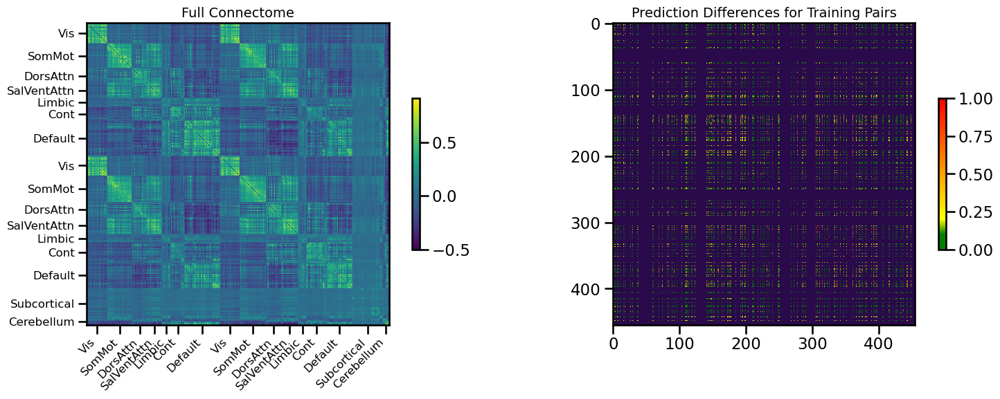

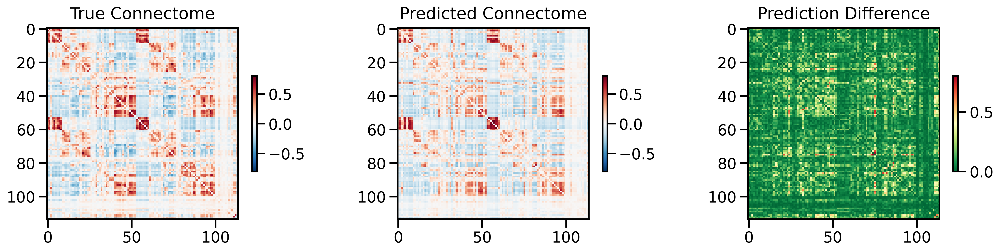

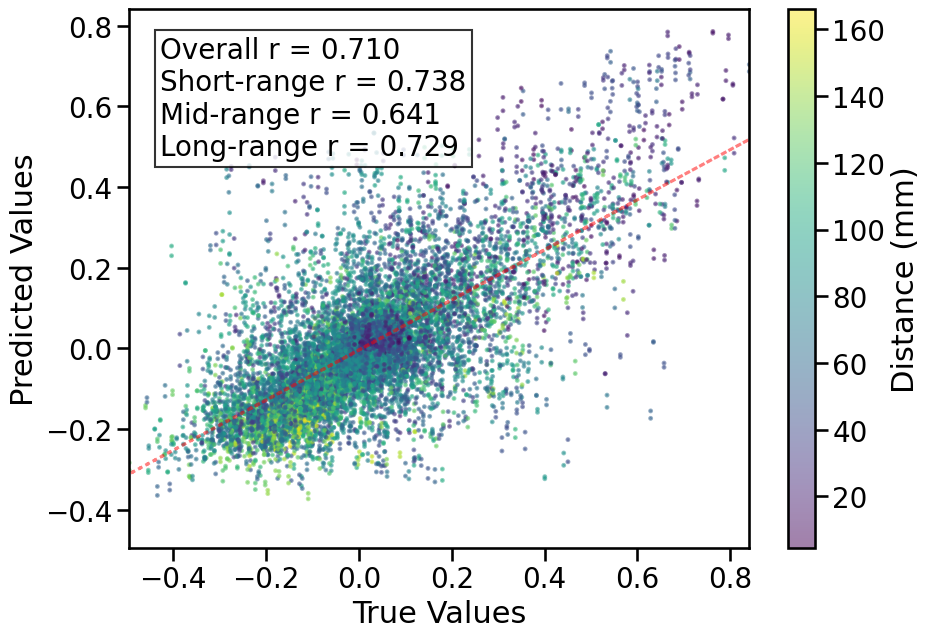


TRAIN METRICS: {'mse': 0.0018914616, 'mae': 0.03263056, 'r2': 0.9432344571282696, 'pearson_r': 0.9745594052369556, 'short_r': 0.9745190843154102, 'mid_r': 0.9726368421827508, 'long_r': 0.9717755853574361, 'geodesic_distance': 15.67971767233063}
TEST METRICS: {'mse': 0.01892287, 'mae': 0.09556575, 'r2': 0.4746422995251478, 'pearson_r': 0.71010522866307, 'short_r': 0.7381944864465119, 'mid_r': 0.6405398340956037, 'long_r': 0.7291606695185755, 'geodesic_distance': 12.748306247018624}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'cls_init': 'spatial_learned', 'use_alibi': True, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 70, 'aug_prob': 0.45}
CPU Usage: 3.3%
RAM Usage: 4.5%
Available RAM: 1.4T
Total RAM: 1.5T
| ID

48957

In [8]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()